In [ ]:
#Saluki	Basenji	Norwich terrier	Shetland sheepdog

In [1]:
#Import all libraries
import cv2 as cv
import pandas as pd
import glob
from PIL import Image 
import numpy as np
import matplotlib.pyplot as plt
import os
from os import listdir
from os.path import isfile,join
from sklearn.decomposition import PCA
import math
from PIL import Image
import xml.etree.ElementTree as ET
from sklearn.preprocessing import StandardScaler
from pathlib import Path
import cv2
import numpy as np
import random


In [2]:
# Define the paths and variables
dog_images = glob.glob('/Users/Documents/Sreenu_images/*/*')
annotations_dir = '/Users/Documents/Sreenu_annot'
annotations=glob.glob('/Users/Documents/Sreenu_annot/*/*')

cropped = "./SCropped/"
img_size = 299  # For Xception input
train_dir = './SCropped'  # './Images'
batch_size_training = 256
batch_size_validation = 256
input_shape = (img_size, img_size, 3)

Cropping and Resizing images

In [3]:
# The function to extract bounding boxes
def get_bounding_boxes(annot):
    xml = annot
    tree = ET.parse(xml)
    root = tree.getroot()
    objects = root.findall('object')
    bbox = []
    for o in objects:
        bndbox = o.find('bndbox')
        xmin = int(bndbox.find('xmin').text)
        ymin = int(bndbox.find('ymin').text)
        xmax = int(bndbox.find('xmax').text)
        ymax = int(bndbox.find('ymax').text)
        bbox.append((xmin, ymin, xmax, ymax))
    return bbox

In [4]:
# Create the output directory for cropped and resized images
os.makedirs(cropped, exist_ok=True)

In [5]:
annotations=glob.glob('/Users/Documents/Sreenu_annot/*/*')

In [6]:
######## Get image path from annotation path ########
def get_image(annot):
    img_path = '/Users/Documents/Sreenu_images/'
    file = annot.split('/')
    img_filename = img_path + file[-2]+'/'+file[-1]+'.jpg'
    return img_filename


In [7]:

for i in range(len(dog_images)):
    bbox = get_bounding_boxes(annotations[i])
    dog = get_image(annotations[i])
    im = Image.open(dog)
    for j in range(len(bbox)):
        im2 = im.crop(bbox[j])
        im2 = im2.resize((128,128), Image.ANTIALIAS)
        new_path = dog.replace('/Users/Documents/Sreenu_images/','./SCropped/')
        new_path = new_path.replace('.jpg','-' + str(j) + '.jpg')
        im2=im2.convert('RGB')
        head, tail = os.path.split(new_path)
        Path(head).mkdir(parents=True, exist_ok=True)
        im2.save(new_path)

/var/folders/lq/2_6xns4s5kdf1420gt7mfn_c0000gn/T/ipykernel_56278/133454832.py:7: DeprecationWarning: ANTIALIAS is deprecated and will be removed in Pillow 10 (2023-07-01). Use LANCZOS or Resampling.LANCZOS instead.
  im2 = im2.resize((331,331), Image.ANTIALIAS)


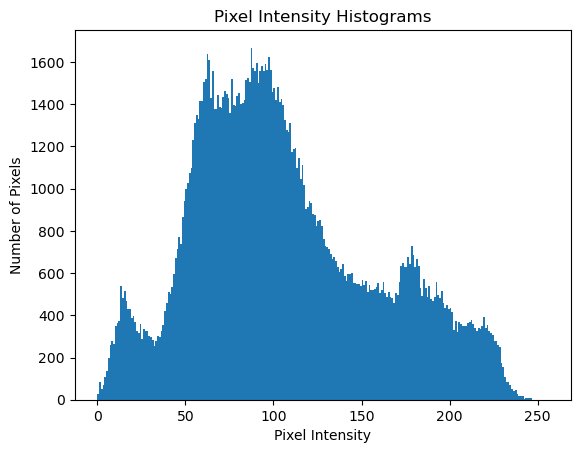

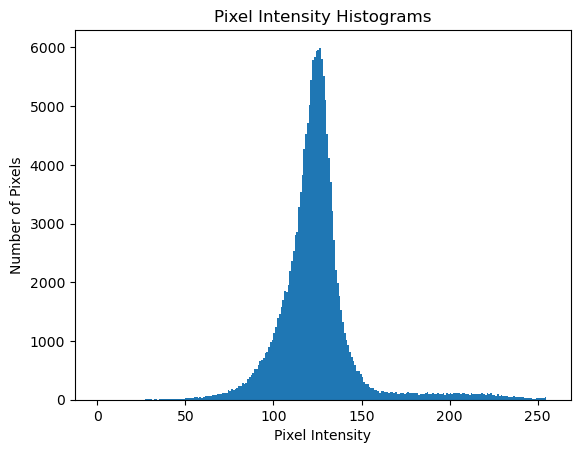

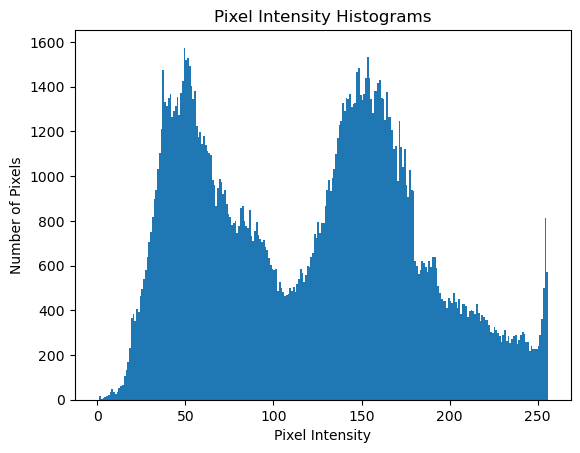

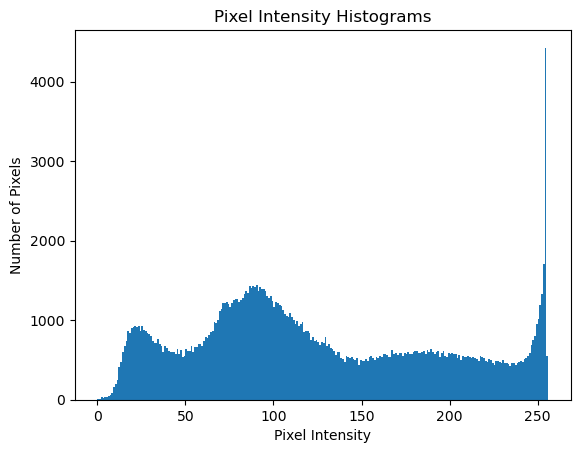

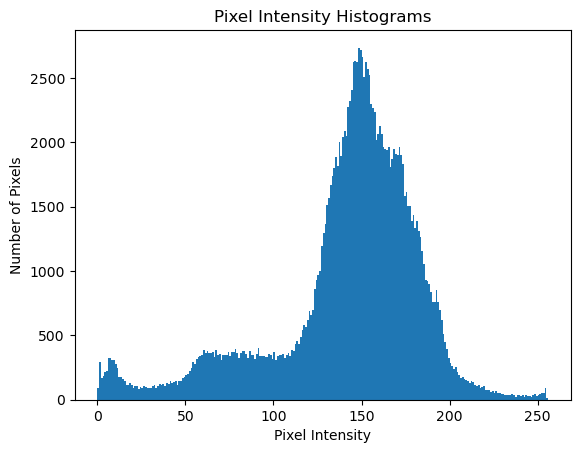

...

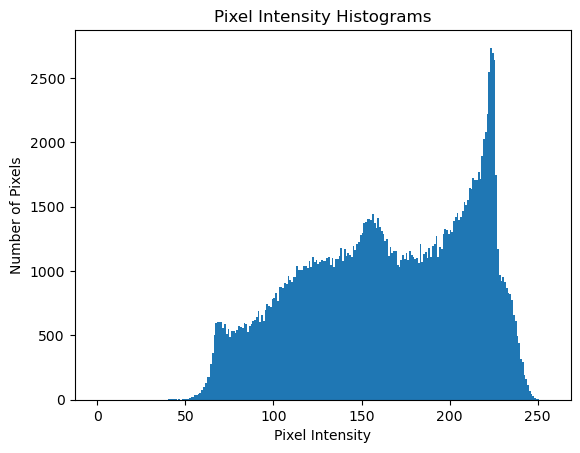

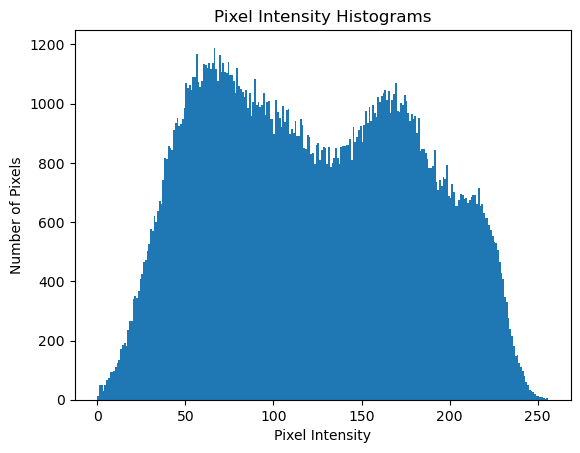

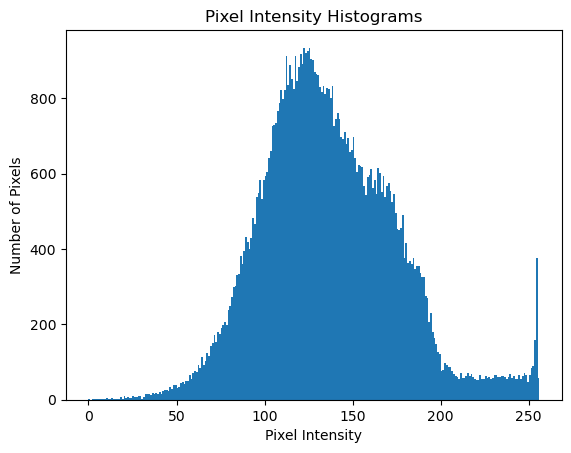

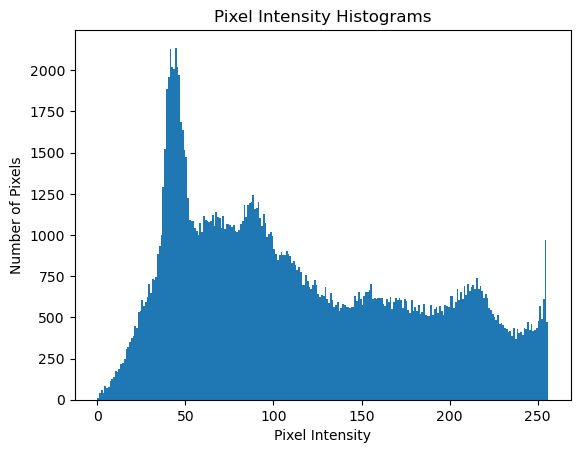

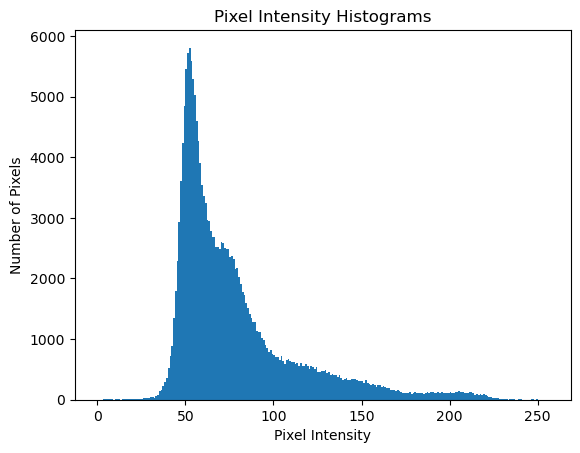

In [8]:
# Iterate over dog images
destination = '/Users/Documents/'
source_path = '/Users/Documents/Sreenu_images/'
#convert the color images to grayscales images using iteration
for image in dog_images:
    img = cv.imread(os.path.join(source_path, image))
    gray = cv.cvtColor(img, cv.COLOR_BGR2GRAY)
    output_image_path = os.path.join(destination, os.path.basename(image))  # Use the same filename

    # Save the grayscale image with an appropriate file extension (e.g., '.jpg', '.png')
    cv.imwrite(output_image_path, gray)

    # Plot the pixel intensity histogram
    plt.hist(x=gray.ravel(), bins=256, range=[0, 256])
    plt.title("Pixel Intensity Histograms")
    plt.ylabel("Number of Pixels")
    plt.xlabel("Pixel Intensity")
    plt.show()

In [10]:
import glob
# Use glob to get a list of all image files
dog_images = glob.glob('/Users/Documents/Sreenu_images/*/*')

# Initialize lists to store images and histograms
grayscale_images = []
histograms = []
equalized_images = []
equalized_histograms = []
color_images = []

# Iterate over class directories
for class_dir in dog_images:
    # Select 2 random image files from each class (if available)
    if len(dog_images) >= 2:
        selected_images = random.sample(dog_images, 2)

        # Process the selected images
        for image_file in selected_images:
            # Load the color image
            color_image = cv2.imread(image_file)

            # Convert the color image to grayscale
            grayscale_image = cv2.cvtColor(color_image, cv2.COLOR_BGR2GRAY)

            # Calculate and store the histogram of the grayscale image
            hist = cv2.calcHist([grayscale_image], [0], None, [256], [0, 256])

            # Perform histogram equalization on the grayscale image
            equalized_image = cv2.equalizeHist(grayscale_image)

            # Calculate and store the histogram of the equalized grayscale image
            equalized_hist = cv2.calcHist([equalized_image], [0], None, [256], [0, 256])

            # Append images and histograms to their respective lists
            grayscale_images.append(grayscale_image)
            histograms.append(hist)
            equalized_images.append(equalized_image)
            equalized_histograms.append(equalized_hist)

<Figure size 1200x1200 with 0 Axes>

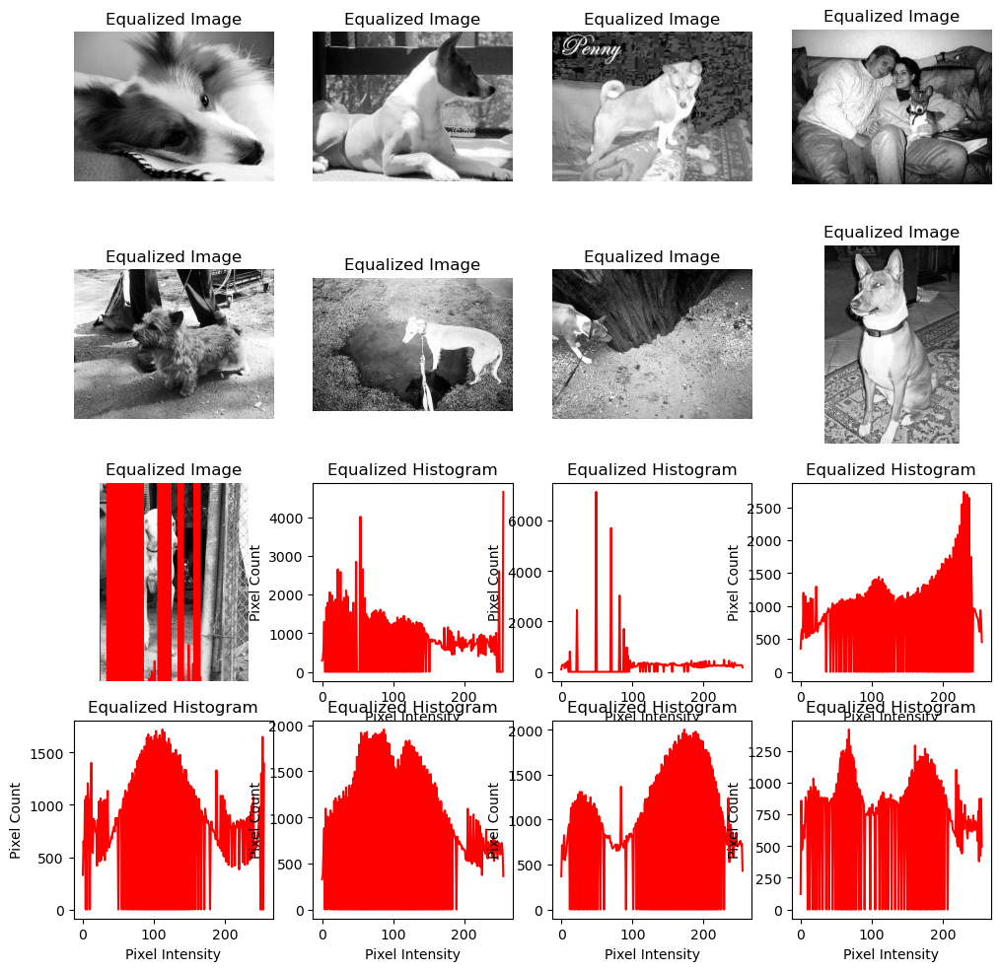

In [72]:
# Plot the 8 grayscale images with histograms
plt.figure(figsize=(12, 12))
try:
    for i in range(len(grayscale_images)):
        plt.subplot(4, 4, i + 1)
        plt.imshow(grayscale_images[i], cmap='gray')
        plt.title('Grayscale Image')
        plt.axis('off')

        plt.subplot(4, 4, i + 9)
        plt.plot(histograms[i], color='b')
        plt.title('Histogram')
        plt.xlabel('Pixel Intensity')
        plt.ylabel('Pixel Count')

    # Plot the 8 equalized grayscale images with histograms
    plt.figure(figsize=(12, 12))
    for i in range(len(equalized_images)):
        plt.subplot(4, 4, i + 1)
        plt.imshow(equalized_images[i], cmap='gray')
        plt.title('Equalized Image')
        plt.axis('off')

        plt.subplot(4, 4, i + 9)
        plt.plot(equalized_histograms[i], color='r')
        plt.title('Equalized Histogram')
        plt.xlabel('Pixel Intensity')
        plt.ylabel('Pixel Count')
except ValueError:
    pass

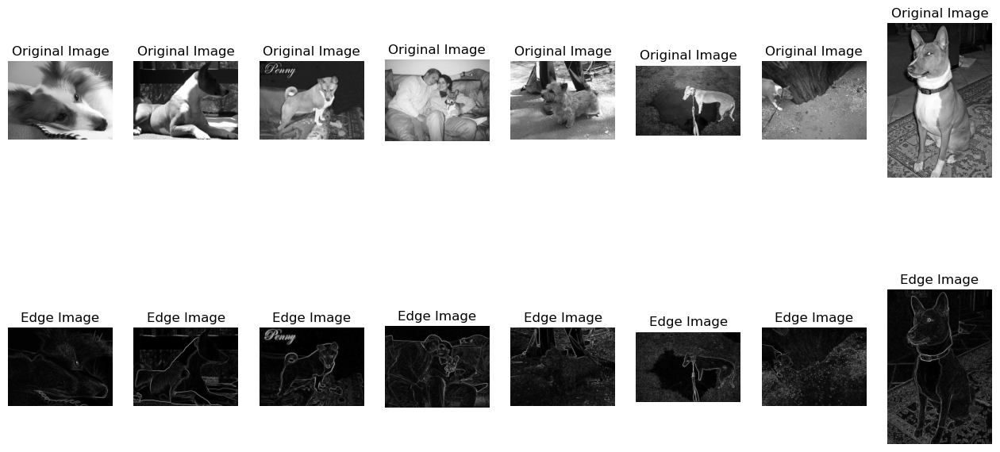

In [36]:
#Sobel edge images

import matplotlib.pyplot as plt
from skimage import io, color, filters
import numpy as np

# Plot the 8 grayscale images and their corresponding edge images
plt.figure(figsize=(16, 8))

for i in range(8):  # Ensure only 8 images are processed
    # Perform edge detection using the Sobel filter
    edges = filters.sobel(grayscale_images[i])

    # Plot the original grayscale image
    plt.subplot(2, 8, i + 1)
    plt.imshow(grayscale_images[i], cmap='gray')
    plt.title('Original Image')
    plt.axis('off')

    # Plot the corresponding edge image
    plt.subplot(2, 8, i + 9)
    plt.imshow(edges, cmap='gray')
    plt.title('Edge Image')
    plt.axis('off')

plt.show()




c) Edge histogram

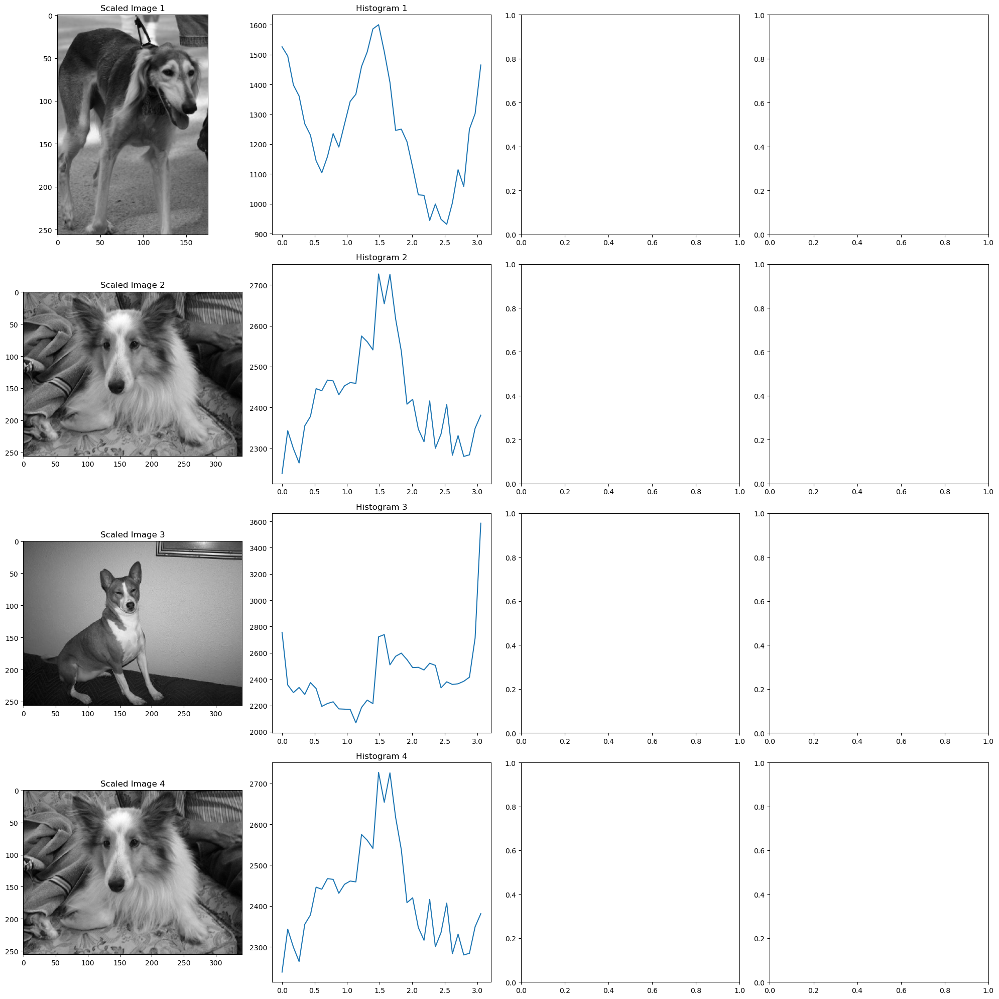

In [68]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
from skimage import filters, exposure, transform

# Define the angle function
def angle(dx, dy):
    """Calculate the angles between horizontal and vertical operators."""
    return np.mod(np.arctan2(dy, dx), np.pi)

# Function to load and scale images
def load_and_scale_images(image_paths, target_size=(256, 256)):
    scaled_images = []
    for path in image_paths:
        color_image = cv2.imread(path)
        if color_image is None:
            raise ValueError(f"Could not load the image: {path}")
        # Convert the color image to grayscale
        gray_image = cv2.cvtColor(color_image, cv2.COLOR_BGR2GRAY)
        # Rescale the grayscale image
        rescaled_image = transform.rescale(gray_image, scale=target_size[0] / gray_image.shape[0])
        scaled_images.append(rescaled_image)
    return scaled_images

# Load and scale the four images
image_paths = [
    "/Users/Documents/Sreenu_Images/n02091831-Saluki/n02091831_38.jpg",
    "/Users/Documents/Sreenu_Images/n02105855-Shetland_sheepdog/n02105855_142.jpg",
    "/Users/Documents/Sreenu_Images/n02110806-basenji/n02110806_17.jpg",
    "/Users/Documents/Sreenu_Images/n02105855-Shetland_sheepdog/n02105855_142.jpg"
]
scaled_images = load_and_scale_images(image_paths, target_size=(256, 256))

# Compute the angle for each pixel in the scaled images
angles = [angle(filters.sobel_h(image), filters.sobel_v(image)) for image in scaled_images]

# Compute the edge histograms for the scaled images
histograms = [np.histogram(angle.reshape(-1), bins=36, range=[0, np.pi]) for angle in angles]

# Plot the scaled images and their corresponding edge histograms side by side
fig, axs = plt.subplots(4, 4, figsize=(20, 20))
for i in range(4):
    axs[i, 0].imshow(scaled_images[i], cmap='gray')
    axs[i, 0].set_title(f"Scaled Image {i+1}")
    axs[i, 1].plot(histograms[i][1][:-1], histograms[i][0])
    axs[i, 1].set_title(f"Histogram {i+1}")

# Adjust layout for better visualization
plt.tight_layout()
plt.show()



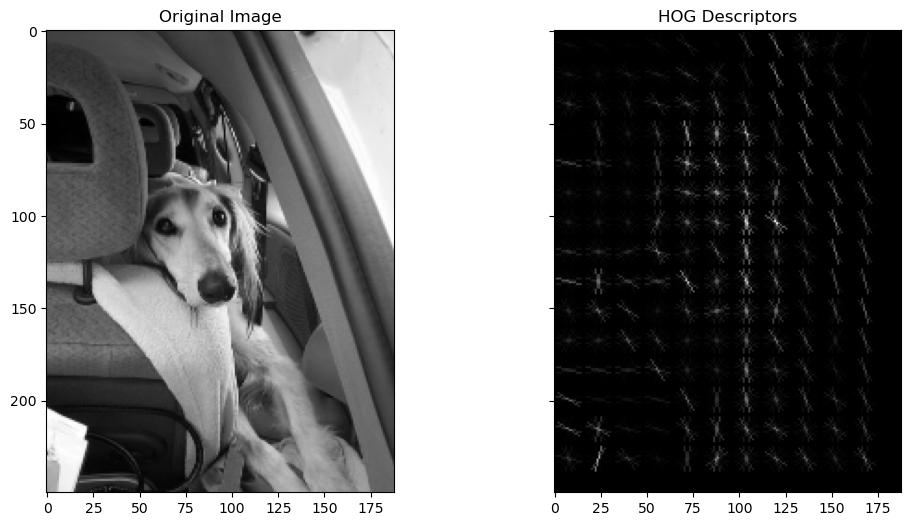

In [54]:
import matplotlib.pyplot as plt
from skimage import exposure
from skimage.feature import hog
from skimage import io, color
from skimage.transform import rescale

# Load the image (replace 'your_image_path' with the actual path to your image)
image_path = '/Users/Documents/Sreenu_Images/n02091831-Saluki/n02091831_55.jpg'
original_image = io.imread(image_path)

# Convert the image to grayscale
gray_image = color.rgb2gray(original_image)

# Resize the image for better visualization
rescaled_image = rescale(gray_image, 0.5)

# Calculate the HOG features
fd, hog_image = hog(rescaled_image, orientations=8, pixels_per_cell=(16, 16),
                    cells_per_block=(1, 1), visualize=True)

# Visualize the original and HOG images
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6), sharex=True, sharey=True)

ax1.imshow(rescaled_image, cmap=plt.cm.gray)
ax1.set_title('Original Image')

# Rescale histogram for better visualization of HOG features
hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))

ax2.imshow(hog_image_rescaled, cmap=plt.cm.gray)
ax2.set_title('HOG Descriptors')

plt.show()



In [48]:
import glob
import cv2
import os
import numpy as np
from scipy.spatial.distance import cosine

# Function to compute histogram distance metrics
def compare_histograms(hist1, hist2):
    # Euclidean Distance
    euclidean_dist = np.linalg.norm(hist1 - hist2)
    
    # Manhattan Distance
    manhattan_dist = np.sum(np.abs(hist1 - hist2))
    
    # Cosine Distance
    cosine_dist = cosine(hist1.flatten(), hist2.flatten())
    
    return euclidean_dist, manhattan_dist, cosine_dist

# Use glob to get a list of all image files
dog_images = glob.glob('/Users/Documents/Sreenu_images/*/*')

# Initialize lists to store images and histograms
grayscale_images = []
histograms = []

# Iterate over class directories and select 2 images from the same class and 1 image from another class
selected_images = []
for class_dir in dog_images:
    # List image files in the class directory
    image_files = dog_images
    
    # Select 2 random images from the same class and 1 image from another class (if available)
    if len(image_files) >= 3:
        selected_images.extend(image_files[:2])  # 2 images from the same class
        selected_images.append(image_files[2])    # 1 image from another class
        
# Compute grayscale histograms for the selected images
for image_path in selected_images:
    # Load the color image
    color_image = cv2.imread(image_path)
    
    # Convert the color image to grayscale
    grayscale_image = cv2.cvtColor(color_image, cv2.COLOR_BGR2GRAY)
    
    # Calculate and store the grayscale histogram
    hist = cv2.calcHist([grayscale_image], [0], None, [256], [0, 256])
    
    # Normalize the histogram
    hist /= hist.sum()
    
    histograms.append(hist)

# Calculate histogram distance metrics for the selected images
same_class_metrics = compare_histograms(histograms[0], histograms[1])
different_class_metrics = compare_histograms(histograms[0], histograms[2])

# Print the computed metrics
print("Metrics for Images from the Same Class:")
print("Euclidean Distance:", same_class_metrics[0])
print("Manhattan Distance:", same_class_metrics[1])
print("Cosine Distance:", same_class_metrics[2])

print("\nMetrics for Images from Different Classes:")
print("Euclidean Distance:", different_class_metrics[0])
print("Manhattan Distance:", different_class_metrics[1])
print("Cosine Distance:", different_class_metrics[2])



Metrics for Images from the Same Class:
Euclidean Distance: 0.12595181
Manhattan Distance: 1.1957188
Cosine Distance: 0.5151068270206451

Metrics for Images from Different Classes:
Euclidean Distance: 0.046289403
Manhattan Distance: 0.59107375
Cosine Distance: 0.19265705347061157


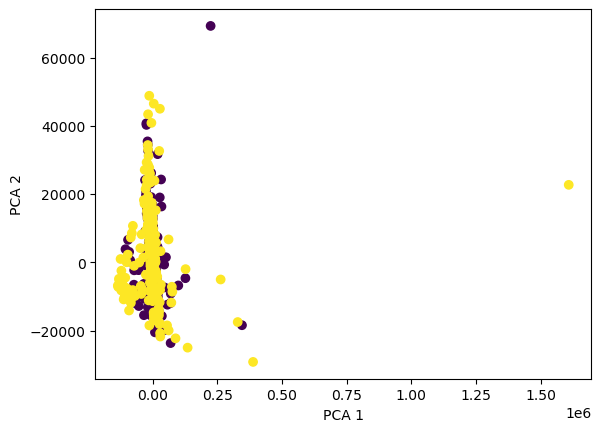

In [57]:
import numpy as np
import cv2
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Load the images from the two classes
class1_images = [cv2.imread(f"/Users/Documents/Sreenu_Images/n02091831-Saluki/{f}") for f in os.listdir("/Users/dinakarreddy/Documents/Sreenu_Images/n02091831-Saluki")]
class2_images = [cv2.imread(f"/Users/Documents/Sreenu_Images/n02094258-Norwich_terrier/{f}") for f in os.listdir("/Users/dinakarreddy/Documents/Sreenu_Images/n02094258-Norwich_terrier")]

# Convert the images to edge histograms
edge_histograms = []
for image in class1_images + class2_images:
   # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    
    # Compute the edge map
    edges = cv2.Canny(gray, 100, 200)
    
    # Compute the histogram of the edge map
    hist, bins = np.histogram(edges.reshape(-1), 256, [0, 256])
   
    # Append the histogram to the list
    edge_histograms.append(hist)

# Convert the list of edge histograms to a NumPy array
edge_histograms = np.array(edge_histograms)
# Perform PCA dimensionality reduction
pca = PCA(n_components=2)
pca_features = pca.fit_transform(edge_histograms)

# Plot the 2D points using 2 different colors for data from the 2 classes
plt.scatter(pca_features[:, 0], pca_features[:, 1], c=[0]*len(class1_images) + [1]*len(class2_images))
plt.xlabel("PCA 1")
plt.ylabel("PCA 2")
plt.show()